<a href="https://colab.research.google.com/github/srujanreddy2021/AI_ML_IITH_Projects_Labs/blob/main/water_loading_with_water_level_reindexing_and_normalizing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reindexing and Norlizing

In [105]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
pd.options.plotting.backend = "plotly"
from scipy.signal import butter, filtfilt

folder_name='/content'

## Functions

data_load: to load flush,washing machine, geyser

load_water_data : to load water level data

volume_calculate : to calculate volume



In [106]:

def data_load(path,start_timestamp=None,end_timestamp=None):
  df = pd.read_csv(path,parse_dates=['created_at'])
  df = df.drop(columns=['latitude','longitude','elevation','status','entry_id','field3'])
  df = df.rename(columns={'created_at':'Timestamp','field1':'flow_rate','field2':'Volume_per_usage'})
  df = df.set_index(["Timestamp"], drop=True)
  df= df.fillna(0)

  df=df.iloc[start_timestamp:end_timestamp]
  return df

def load_water_data(path,start_timestamp='2024-03-24 18:04:03+05:30',end_timestamp=None):
  water_level_data = pd.read_csv(path,parse_dates=['created_at'])
  water_level_data = water_level_data.drop(columns=['latitude','longitude','elevation','status','entry_id','field1','field2','field7'])
  water_level_data = water_level_data.rename(columns={'created_at':'Timestamp','field6':'distance'})
  water_level_data = water_level_data.set_index(["Timestamp"], drop=True)
  water_level_data=water_level_data[start_timestamp:end_timestamp]
  return water_level_data
  # water_level_data['distance'] = water_level_data['distance'].apply(lambda x: round(x, 1))


def volume_calculate(water_level_df,column_name='distance',with_diff=False):
  if(with_diff):
    water_level_df['change_in_level']= water_level_df[column_name]
  else:
    water_level_df['change_in_level'] = water_level_df[column_name].diff().fillna(0)

  # Tank dimensions (in centimeters)
  tank_height_cm = 37.7 * 2.54  # Convert inches to centimeters
  tank_diameter_cm = 35.8 * 2.54  # Convert inches to centimeters

  # Convert change in water level to liters
  water_level_df['change_in_liters'] = (
      np.pi *( (tank_diameter_cm / 2) ** 2) * water_level_df['change_in_level'] / 1000
  )  # Convert cubic centimeters to liters (1 liter = 1000 cubic centimeters)

  # Calculate time interval between data points
  water_level_df['time_interval'] = water_level_df.index.to_series().diff()

  # Calculate rate of water utilization at every data point (liters per minute)
  water_level_df['utilization_rate_liters_per_minute'] = (
      water_level_df['change_in_liters'] / water_level_df['time_interval'].dt.total_seconds() * 60
  )
  return water_level_df



def plot_Volume_data(change_in_liters_df,tank_out_time='2024-03-26 11:14',tank_out_column='flow_rate'):
  fig = go.Figure()
  # Add traces for each data category
  fig.add_trace(go.Scatter(x=tank_out_data.index.to_series()[tank_out_time:], y=tank_out_data[tank_out_column][tank_out_time :],
                          mode='lines', name=tank_out_column, line=dict(color='lightblue')))
  fig.add_trace(go.Scatter(x=change_in_liters_df.index, y=change_in_liters_df,
                          mode='lines', name='volume in liters', line=dict(color='green')))

  # fig.add_trace(go.Scatter(x=water_level_data.index, y=water_level_data['distance']-50,
  #                         mode='lines', name='water level', line=dict(color='yellow')))


  # Update layout
  fig.update_layout(title=f'water level and water {tank_out_column}',
                    xaxis_title='Timestamp',
                    yaxis_title=tank_out_column)

  # Show the plot
  fig.show()

## loading tankout data and water level

In [107]:
tank_out_data = data_load(f'{folder_name}/tank_out.csv')
tank_out_data =tank_out_data['2024-03-26 11:14':]
tank_out_data['flow_rate'].plot()

In [ ]:
water_level_data = load_water_data(f'{folder_name}/water_level.csv',start_timestamp='2024-03-26 11:14:25+05:30')
# water_level_data = load_water_data(f'{folder_name}/water_level.csv',start_timestamp='2024-03-26 21:12:54+05:30',end_timestamp='2024-03-26 22:12:54+05:30')
water_level_data.plot()

## Fourier tranform

In [ ]:
# Perform Fourier Transform
y = water_level_data['distance'].values
n = len(y)
dt = 1  # Assuming a sampling rate of 1 sample per second
freq = np.fft.fftfreq(n, d=dt)
fft_vals = np.fft.fft(y)
fft_freq = np.fft.fftshift(freq)
fft_shifted = np.fft.fftshift(fft_vals)

# Plot Fourier Transform using Plotly
fig = go.Figure()
fig.add_trace(go.Scatter(x=fft_freq, y=np.abs(fft_shifted), mode='lines', name='Fourier Transform'))
fig.update_layout(title='Fourier Transform of Water Level Data', xaxis_title='Frequency (Hz)',
                  yaxis_title='Amplitude', showlegend=True)
fig.show()

## Appling low pass filter

In [97]:
def low_pass_filter(df,cutoff_freq,column_name='distance',sampling_freq=1,order=2):

  # Calculate filter coefficients
  nyquist_freq = 0.5 * sampling_freq
  normalized_cutoff_freq = cutoff_freq / nyquist_freq
  b, a = butter(order, normalized_cutoff_freq, btype='low')

  # Apply low-pass filter using filtfilt
  smoothed_distance = filtfilt(b, a, df[column_name])

  # Add smoothed data to the dataframe
  df[column_name] = smoothed_distance
  return df

water_level_data = low_pass_filter(water_level_data,0.01,order=2)

In [98]:
water_level_data['distance'].plot()

## resampling and interolating the data to 1 min

In [ ]:
px.histogram(x=water_level_data.index.to_series().diff().dt.total_seconds(),nbins=300)

In [72]:
def resample_data(sampling_rate,water_level_data=water_level_data,tank_out_data=tank_out_data):
  resampled_water_level = water_level_data.resample(sampling_rate).ffill()
  resampled_tank_out = tank_out_data.resample(sampling_rate).ffill()
  return resampled_water_level,resampled_tank_out
resampled_water_level,resampled_tank_out = resample_data('5S')
resampled_water_level.plot()

In [73]:
data= resampled_water_level.fillna(0).copy()
data['distance'] = resampled_water_level['distance'].diff().fillna(0)
# data=data[data['distance'] >= 0]
process_data_smooth_volume_calculate = volume_calculate(data,with_diff = True)
plot_Volume_data(process_data_smooth_volume_calculate['change_in_liters'],tank_out_column='flow_rate')

In [86]:

flow_rate_df = resampled_tank_out.copy()
# utilization_rate_liters_per_minute

process_data_smooth_volume_calculate['utilization_rate_liters_per_minute'] = process_data_smooth_volume_calculate['utilization_rate_liters_per_minute'].apply(lambda x: max(0, x))
process_data_smooth_volume_calculate['time_difference_minutes'] = process_data_smooth_volume_calculate.index.to_series().diff().dt.total_seconds()/ 60
process_data_smooth_volume_calculate['utilization_rate_volume'] = process_data_smooth_volume_calculate['utilization_rate_liters_per_minute'] * process_data_smooth_volume_calculate['time_difference_minutes']
process_data_smooth_volume_calculate['total_volume_liters'] = process_data_smooth_volume_calculate['utilization_rate_volume'].cumsum()

# # change_in_liters
# process_data_smooth_volume_calculate['change_in_liters'] = process_data_smooth_volume_calculate['change_in_liters'].apply(lambda x: max(0, x))
# process_data_smooth_volume_calculate['total_volume_liters'] = process_data_smooth_volume_calculate['change_in_liters'].cumsum()


flow_rate_df['time_difference_minutes'] = flow_rate_df.index.to_series().diff().dt.total_seconds()/ 60  # Convert to minutes
flow_rate_df['volume'] = flow_rate_df['flow_rate'] * flow_rate_df['time_difference_minutes'] # Convert flow rate to liters per minute
flow_rate_df['total_volume_liters'] = flow_rate_df['volume'].cumsum()

# Plot total volume over time from flow rate data
fig = go.Figure()

fig.add_trace(go.Scatter(x=process_data_smooth_volume_calculate.index,
                         y=process_data_smooth_volume_calculate['total_volume_liters'],
                         mode='lines',
                         name='Water Level'))

fig.add_trace(go.Scatter(x=flow_rate_df.index,
                         y=flow_rate_df['total_volume_liters'],
                         mode='lines',
                         name='Flow Sensor'))

fig.update_layout(title='Total Volume Over Time (Flow Rate Data)',
                  xaxis_title='Timestamp',
                  yaxis_title='Total Volume (liters)',
                  xaxis=dict(tickangle=-45),
                  legend=dict(x=0, y=1),
                  margin=dict(l=40, r=40, t=60, b=40),
                  height=600,
                  width=1000)

fig.show()

# Plot utilization rate volume over time
fig2 = go.Figure()

fig2.add_trace(go.Scatter(x=process_data_smooth_volume_calculate.index,
                          y=process_data_smooth_volume_calculate['utilization_rate_volume'],
                          mode='lines',
                          name='Water Level'))

fig2.add_trace(go.Scatter(x=flow_rate_df.index,
                          y=flow_rate_df['volume'],
                          mode='lines',
                          name='Flow Sensor'))

fig2.update_layout(title='Utilization Rate Volume Over Time (Flow Rate Data)',
                   xaxis_title='Timestamp',
                   yaxis_title='Total Volume (liters)',
                   xaxis=dict(tickangle=-45),
                   legend=dict(x=0, y=1),
                   margin=dict(l=40, r=40, t=60, b=40),
                   height=600,
                   width=1000)

fig2.show()

## Correlation

### Total Volume plot

In [87]:
water_levl_total_volume=process_data_smooth_volume_calculate['total_volume_liters']['2024-03-26 11:17':'2024-03-30 15:34'].fillna(0)
corr_df = pd.DataFrame({'water level total volume': water_levl_total_volume,'flow rate total volume':flow_rate_df['total_volume_liters'].fillna(0)})
corr_df.corr()

,water level total volume,flow rate total volume
water level total volume,1.000000,0.978129
flow rate total volume,0.978129,1.000000


### Volume of water level and volume of flow rate

In [95]:
water_levl_total_volume

Timestamp
2024-03-26 11:17:00+05:30    0.0
2024-03-26 11:17:05+05:30    0.0
2024-03-26 11:17:10+05:30    0.0
2024-03-26 11:17:15+05:30    0.0
2024-03-26 11:17:20+05:30    0.0
                            ... 
2024-03-30 15:34:35+05:30    0.0
2024-03-30 15:34:40+05:30    0.0
2024-03-30 15:34:45+05:30    0.0
2024-03-30 15:34:50+05:30    0.0
2024-03-30 15:34:55+05:30    0.0
Freq: 5S, Name: utilization_rate_volume, Length: 72216, dtype: float64

In [101]:
water_level_total_volume=process_data_smooth_volume_calculate['utilization_rate_volume']['2024-03-26 11:17':'2024-03-30 15:34']
# Applying low pass filter

corr_df = pd.DataFrame({'water level volume': water_levl_total_volume,'flow rate volume':flow_rate_df['volume']})
corr_df = low_pass_filter(corr_df,0.05,order=2,column_name='water level volume')
print(corr_df.corr())
corr_df.plot()


                    water level volume  flow rate volume
water level volume            1.000000          0.210678
flow rate volume              0.210678          1.000000


In [89]:

water_levl_total_volume=process_data_smooth_volume_calculate['utilization_rate_liters_per_minute']['2024-03-26 11:17':'2024-03-30 15:34'].rolling(window=15).mean().fillna(0)
corr_df = pd.DataFrame({'water level volume': water_levl_total_volume,'flow rate volume':flow_rate_df['flow_rate']})
print(corr_df.corr())
corr_df.plot()

                    water level volume  flow rate volume
water level volume            1.000000          0.167908
flow rate volume              0.167908          1.000000


# Calcuating out flow and inflow using water level data

In [79]:
data= resampled_water_level.fillna(0).copy()
data.plot()

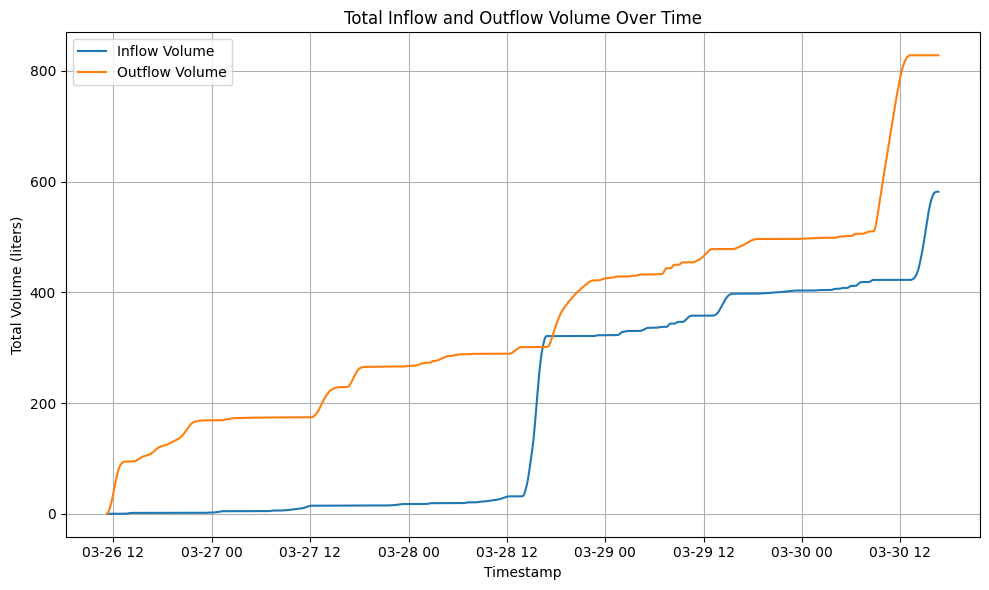

In [104]:
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

class CylindricalTank:
    def __init__(self, radius, height):
        self.radius = radius
        self.height = height
        self.capacity = math.pi * self.radius ** 2 * self.height
        self.current_level = 0
        self.prev_time = None

    def update_level(self, water_level, timestamp):
      if self.prev_time is not None:
          time_difference = (timestamp - self.prev_time).total_seconds() * 60  # Convert to minutes
          if water_level > self.current_level:
              outflow_rate = self.calculate_volume(water_level - self.current_level) / time_difference
              inflow_rate = 0
          elif water_level < self.current_level:
              inflow_rate = self.calculate_volume(self.current_level - water_level) / time_difference
              outflow_rate = 0
          else:
              inflow_rate = np.nan
              outflow_rate = np.nan
          self.prev_time = timestamp
          self.current_level = water_level  # Update current level after calculations
          return inflow_rate, outflow_rate
      else:
        self.prev_time = timestamp
        self.current_level = water_level
        return 0,0

    def calculate_volume(self, height):
        return math.pi * (self.radius ** 2) * height

tank_radius = (35.8 * 2.54)/2
tank_height = 37.7 * 2.54

tank = CylindricalTank(radius=tank_radius, height=tank_height)

# Arrays to store inflow and outflow rates
inflow_rates = np.zeros(len(data))
outflow_rates = np.zeros(len(data))

for index, row in data.reset_index().iterrows():
    inflow_rate, outflow_rate = tank.update_level(row['distance'], row['Timestamp'])
    inflow_rates[index] = inflow_rate
    outflow_rates[index] = outflow_rate

# Add inflow and outflow rates to the DataFrame
data['Inflow Rate (L/min)'] = inflow_rates
data['Inflow Rate (L/min)']= data['Inflow Rate (L/min)'].ffill()
data['Outflow Rate (L/min)'] = outflow_rates
data['Outflow Rate (L/min)']= data['Outflow Rate (L/min)'].ffill()
# Plotting
fig = px.line(data.reset_index(), x='Timestamp', y=['Inflow Rate (L/min)', 'Outflow Rate (L/min)'],
              labels={'value': 'Flow Rate (liters/minute)', 'variable': 'Flow Type'},
              title='Inflow and Outflow Rates Over Time')
fig.update_xaxes(title='Timestamp')
fig.update_yaxes(title='Flow Rate (liters/minute)')
fig.show()

# Calculate total volumes
data['Inflow Volume (liters)'] = data['Inflow Rate (L/min)'].cumsum() / 60  # Convert from liters/minute to liters
data['Outflow Volume (liters)'] = data['Outflow Rate (L/min)'].cumsum() / 60  # Convert from liters/minute to liters

flow_rate_df['time_difference_minutes'] = flow_rate_df.index.to_series().diff().dt.total_seconds()/ 60  # Convert to minutes
flow_rate_df['volume'] = flow_rate_df['flow_rate'] * flow_rate_df['time_difference_minutes'] # Convert flow rate to liters per minute
flow_rate_df['total_volume_liters'] = flow_rate_df['volume'].cumsum()

# Plot total volumes
plt.figure(figsize=(10, 6))
plt.plot(data.index, data['Inflow Volume (liters)'], label='Inflow Volume')
plt.plot(data.index, data['Outflow Volume (liters)'], label='Outflow Volume')
plt.xlabel('Timestamp')
plt.ylabel('Total Volume (liters)')
plt.title('Total Inflow and Outflow Volume Over Time')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()